In [ ]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'  # O '0,1' para usar múltiples GPUs
import tensorflow as tf
tf.test.gpu_device_name()
from PIL import Image
import numpy as np
from tensorflow.keras.utils import Sequence
from glob import glob
import random
import os
import fnmatch

In [2]:
def find_files_with_extensions(root_dir, extensions):
    matched_files = []

    # Recorrer el directorio de forma recursiva
    for root, dirs, files in os.walk(root_dir):
        # Filtrar los directorios para evitar entrar en directorios ocultos
        dirs[:] = [d for d in dirs if not d.startswith('.')]
        
        for pattern in extensions:
            for filename in fnmatch.filter(files, pattern):
                # Omitir archivos ocultos
                if not filename.startswith('.'):
                    matched_files.append(os.path.join(root, filename))

    return matched_files

# Ejemplo de uso
root_directory = "dataset4k"
file_extensions = ['*.png', '*.jpg']  # Extensiones a buscar

dataset = find_files_with_extensions(root_directory, file_extensions)
print(len(dataset))

4048


In [3]:
class XYGenerator(Sequence):
    def __init__(self, data, batch_size, readers, training = False):
        self.data = data
        self.batch_size = batch_size
        self.readers = readers
        self.training = training
    def __len__(self):
        return int(np.ceil(len(self.data)/float(self.batch_size)))
    
    def __getitem__(self,idx):
        batch = self.data[ idx * self.batch_size: (idx + 1) * self.batch_size]
        x = []
        y = []
        for filename in batch:
            x_, y_ = self.readers(filename,self.training)
            x.append(x_)
            y.append(y_)
        return np.array(x), np.array(y)

In [4]:
def resize_image_if_exceeds(image, max_width, max_height):
    # Obtener dimensiones originales
    original_width, original_height = image.size
    
    # Verificar si las dimensiones exceden el límite
    if original_width > max_width or original_height > max_height:
        # Calcular las nuevas dimensiones manteniendo la relación de aspecto
        if original_width > original_height:
            # Redimensionar basado en el ancho máximo
            scale_factor = max_width / original_width
            new_width = max_width
            new_height = int(original_height * scale_factor)
        else:
            # Redimensionar basado en el alto máximo
            scale_factor = max_height / original_height
            new_width = int(original_width * scale_factor)
            new_height = max_height

        # Redimensionar la imagen
        resized_image = image.resize((new_width, new_height), Image.Resampling.LANCZOS)
        return resized_image
    else:
        # La imagen no necesita redimensionamiento
        return image


In [5]:
def crop_image_randomly(image, training = True):
    if not training:
        return image
    width, height = image.size

    # Calcula los tamaños máximos para el recorte (entre el 90% y el 100% del tamaño original)
    random.uniform(0.65, 0.95)
    min_crop_width = int(width * 0.8)
    min_crop_height = int(height * 0.8)
    max_crop_width = width
    max_crop_height = height

    # Genera dimensiones aleatorias para el recorte
    crop_width = random.randint(min_crop_width, max_crop_width)
    crop_height = random.randint(min_crop_height, max_crop_height)

    # Genera coordenadas aleatorias para el recorte
    left = random.randint(0, width - crop_width)
    top = random.randint(0, height - crop_height)
    right = left + crop_width
    bottom = top + crop_height

    # Realiza el recorte
    return image.crop((left, top, right, bottom))

In [55]:
import random
import math
def resize_image_randomly(image, training = True):
    original_width, original_height = image.size
    scale_factor =  random.uniform(0.1, 0.25) if training else 0.15
    new_width = int(original_width * scale_factor)
    new_height = int(original_height * scale_factor)
    resized_image = image.resize((new_width, new_height))
    return resized_image.resize((original_width, original_height), Image.BICUBIC)

In [56]:
def calculate_size(size, layers):
    x = size
    for i in range(layers):
        x = math.ceil(x / 2)
    return int(x * ( 2** layers))
    
def fix_image_size(img,layers):
    initial_width, initial_height = img.size
    new_width = calculate_size(initial_width,layers)
    new_height = calculate_size(initial_height,layers)
    return img.resize((new_width,new_height))

def rotate_image_randomly(img, training = True):
    if not training:
        return img
    angle = random.uniform(-5, 5)
    return img.rotate(angle, expand=False)

def read_x_y(filename, training = True):
    output_ = resize_image_if_exceeds(crop_image_randomly(rotate_image_randomly(Image.open(filename).convert("RGB"), training),training),2048,2048)
    output_ = fix_image_size(output_,2)
    
    input_ = resize_image_randomly(output_, training)#.resize((256,256)).resize((1024,1024), Image.BICUBIC)
    
    arr_input_ = np.array(input_)
    arr_output_ = np.array(output_)
    
    flip_random = random.random()
    if training:
        if flip_random < .3:
            arr_input_ = arr_input_[:, ::-1]
            arr_output_ = arr_output_[:, ::-1]
        elif flip_random < .6:
            arr_input_ = arr_input_[::-1, :]
            arr_output_ = arr_output_[::-1, :]
            
    return (arr_input_ / 127.5) - 1 , (arr_output_/ 127.5) - 1


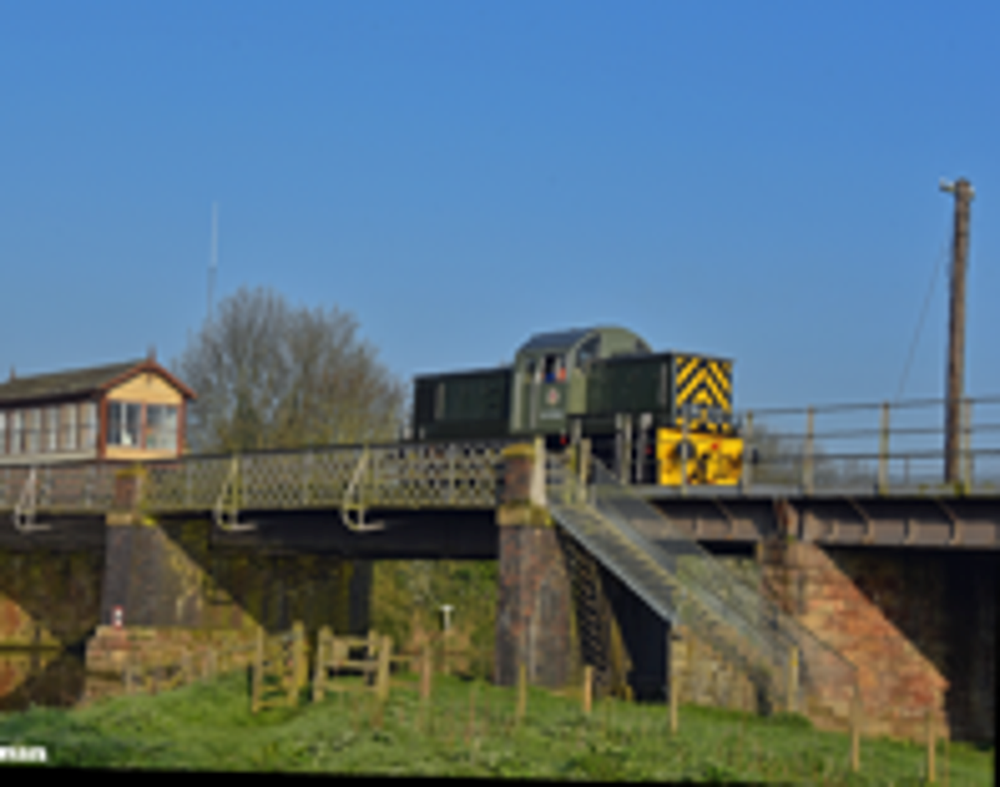

In [11]:
r = read_x_y(dataset[0])
x = Image.fromarray(np.uint8((r[0] + 1) * 127.5))
y = Image.fromarray(np.uint8((r[1] + 1) * 127.5))
x

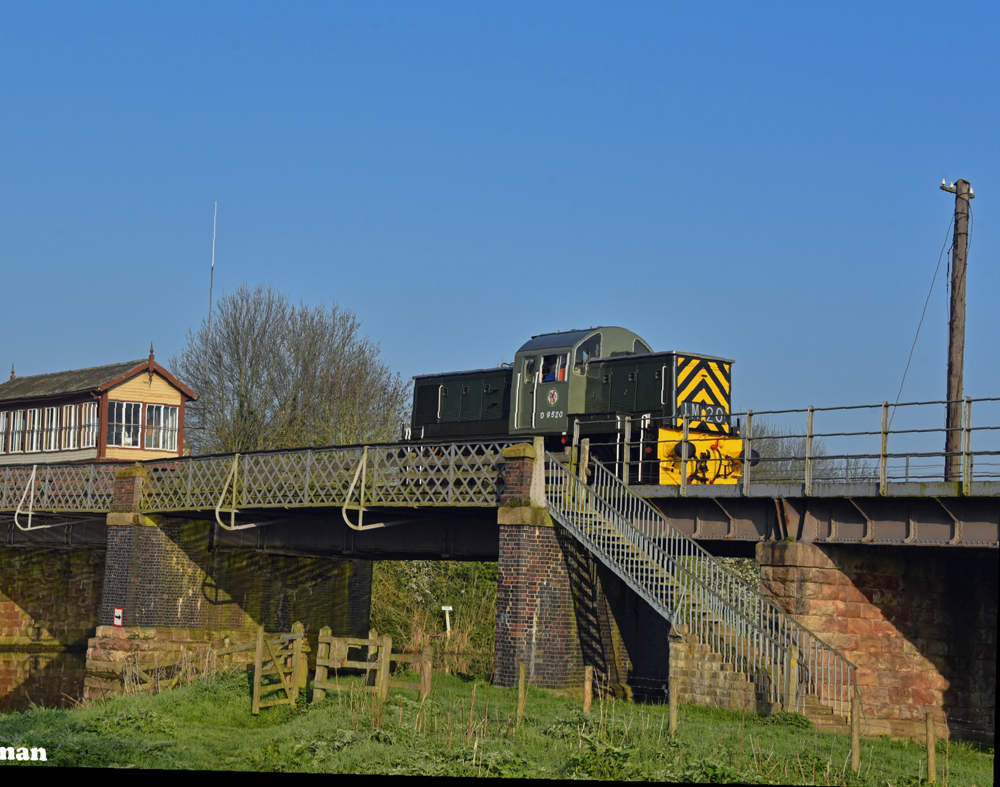

In [12]:
y

In [13]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(dataset,test_size = 0.1, random_state = 30)
print(len(train))
print(len(test))

batch_size= 1

training_generator = XYGenerator(train,batch_size,read_x_y,training = True)
test_generator = XYGenerator(test,batch_size,read_x_y, training=False)

3643
405


In [57]:
test_generator = XYGenerator(test,batch_size,read_x_y, training=False)

In [14]:
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
import tensorflow as tf


def Res(n = 64):
    def wrapper(inputs):
        x = SeqConv(n, 3, 1)(inputs)
        x = ReLU()(x)
        x = SeqConv(n, 3, 1)(x)
        return inputs + x
    return wrapper

def SeqConv(n, kernel_size, strides):
    def wrapper(x):
        initializer = tf.random_normal_initializer(0., 0.02)
        x = Conv2D(n, kernel_size, strides=strides, padding = 'same', kernel_initializer= initializer, use_bias=False)(x)
        return BatchNormalization()(x)
    return wrapper

def SeqConvT(n, kernel_size, strides, activation = None):
    def wrapper(x):
        initializer = tf.random_normal_initializer(0., 0.02)
        x = Conv2DTranspose(n, kernel_size,strides=strides, padding = 'same', activation = activation, kernel_initializer= initializer, use_bias=False)(x)
        return BatchNormalization()(x)
    return wrapper

def enhance_net():
    inputs = Input(shape=(None, None, 3))
    
    conv1 = SeqConv(64, 4, 2)(inputs)
    conv1 = LeakyReLU()(conv1)
    conv2 = SeqConv(32, 4, 2)(conv1)
    conv2 = LeakyReLU()(conv2)
    
    x = conv2
    
    for i in range(10):
        x = Res(32)(x)

    add1 = Add()([x, conv2])
    conv3 = SeqConvT(64, 4, 2)(add1)
    conv3 = ReLU()(conv3)
    add2 = Add()([conv3, conv1])
    conv4 = SeqConvT(3, 4, 2, 'tanh')(add2)
    
    return Model(inputs = inputs, outputs = Add()([conv4 , inputs]))
    

In [15]:
model = enhance_net()
model.summary()

2024-09-05 18:36:42.656117: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-09-05 18:36:42.656356: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-09-05 18:36:42.656500: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, None, None, 64)       3072      ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, None, None, 64)       256       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, None, None, 64)       0         ['batch_normalization[0][0

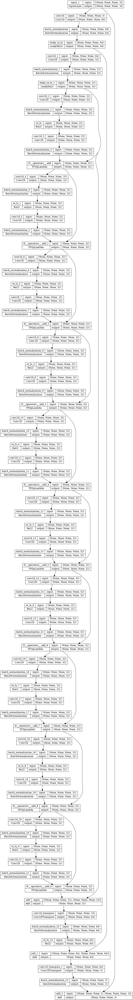

In [16]:
tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)

In [17]:
model.compile(optimizer = Adam(0.001), loss= 'mse' , metrics = ['accuracy'])#"categorical_crossentropy"

In [15]:
model.fit(training_generator, validation_data= test_generator, epochs= 5)

Epoch 1/5


2024-09-05 12:56:50.594547: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8600
2024-09-05 12:56:51.935321: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7b546cb5d5b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-09-05 12:56:51.935339: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2024-09-05 12:56:51.948142: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-09-05 12:56:52.079463: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


3643/3643 [==============================] - 5297s 1s/step - loss: 0.0445 - accuracy: 0.7677 - val_loss: 0.0158 - val_accuracy: 0.7590
Epoch 2/5
3643/3643 [==============================] - 4437s 1s/step - loss: 0.0184 - accuracy: 0.8919 - val_loss: 0.0138 - val_accuracy: 0.9018
Epoch 3/5
3643/3643 [==============================] - 3778s 1s/step - loss: 0.0171 - accuracy: 0.9138 - val_loss: 0.0139 - val_accuracy: 0.9081
Epoch 4/5
3643/3643 [==============================] - 3220s 884ms/step - loss: 0.0166 - accuracy: 0.9101 - val_loss: 0.0132 - val_accuracy: 0.8942
Epoch 5/5
3643/3643 [==============================] - 2836s 779ms/step - loss: 0.0164 - accuracy: 0.9095 - val_loss: 0.0131 - val_accuracy: 0.9229


In [18]:
#model = tf.keras.models.load_model('enhance_net_copy9')


In [17]:
model_output_path = 'enhance_net_copy9'
model.save(model_output_path)


INFO:tensorflow:Assets written to: enhance_net_copy9/assets


INFO:tensorflow:Assets written to: enhance_net_copy9/assets


In [58]:
def predict(model, X, samples = 10):
    return [[model.predict(X[i:i+1],verbose = 0)[0]] for i in range(samples)]

def get_pred_true(model, generator,batch_size=1, samples = 10): #test
    X = []
    y_true = []
    x = 0
    for x, batch in enumerate(generator):
        if x >= samples:
            break
        X.append(batch[0])
        y_true.append(batch[1])
        x+=batch_size
        
    return X, y_true, predict(model,X,samples)


In [59]:
X, y_true, y_pred = get_pred_true(model, test_generator, samples = 15)


In [60]:
def arr_to_img(arr):
    return Image.fromarray(np.uint8(np.clip(arr, 0, 255)))


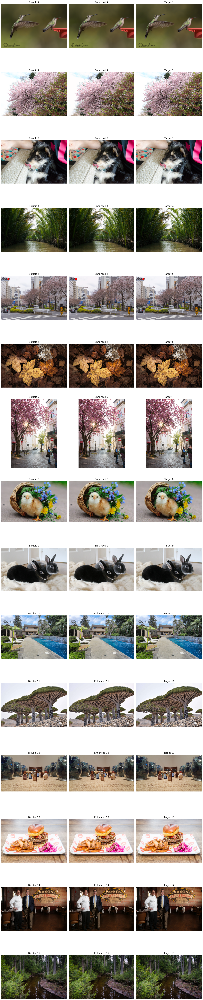

In [61]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

nework_name = "enhance_net_9"
def show_image_comparison(target_images, bicubic_images, enhanced_images):
    num_images = len(target_images)

    # Crear una figura con subplots
    fig, axes = plt.subplots(nrows=num_images, ncols=3, figsize=(15, num_images * 5))
    
    for i in range(num_images):
        # Muestra la imagen bicubic en la primera columna
        axes[i, 0].imshow(bicubic_images[i])
        bicubic_images[i].save(f"{nework_name}_Bicubic_{i + 1}.jpg")
        axes[i, 0].set_title(f"Bicubic {i + 1}")
        axes[i, 0].axis('off')  # Oculta los ejes
        
        # Muestra la imagen enhanced en la segunda columna
        axes[i, 1].imshow(enhanced_images[i])
        enhanced_images[i].save(f"{nework_name}_Enhanced_{i + 1}.jpg")
        axes[i, 1].set_title(f"Enhanced {i + 1}")
        axes[i, 1].axis('off')  # Oculta los ejes

        # Muestra la imagen target en la tercera columna
        axes[i, 2].imshow(target_images[i])
        target_images[i].save(f"{nework_name}_Target_{i + 1}.jpg")
        axes[i, 2].set_title(f"Target {i + 1}")
        axes[i, 2].axis('off')  # Oculta los ejes
        
    plt.tight_layout()
    plt.show()


bicubic_images = [arr_to_img((x[0] + 1) * 127.5) for x in X]
enhanced_images = [arr_to_img((y_p[0]+ 1) * 127.5) for y_p in y_pred]
target_images = [arr_to_img((y_t[0]+ 1) * 127.5) for y_t in y_true]

show_image_comparison(target_images, bicubic_images, enhanced_images)